# Overylaying our in vitro sigs and Mulder et al sigs on atlas

In [1]:
#load packages I need
import os
import tools
import scanpy as sc
import pandas as pd
import dandelion as ddl
from tqdm import tqdm
import matplotlib.pyplot as plt
import scanpy.external as sce
from matplotlib.pyplot import rc_context
import seaborn as sns

In [2]:
#set current directory 
os.chdir('/scratch/user/s4436039/scdata/Myeloid_Objects')
os.getcwd()

'/scratch/user/s4436039/scdata/Myeloid_Objects'

In [3]:
# read in data
data_DC = sc.read_h5ad('20250617_AllDC_bbknn.h5ad')
data = sc.read_h5ad('NRclean_clustered2.h5ad')
data_DC2 = sc.read_h5ad('20250629_DC2_bbknn_clustered2.h5ad') 

In [4]:
# Set colours for NR_annotations_simple plot:
data_DC.uns["NR_annotations_simple_colors"] = ['#e377c2', '#aa40fc', '#8c564b']  

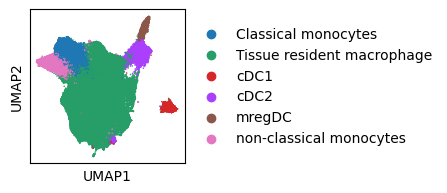

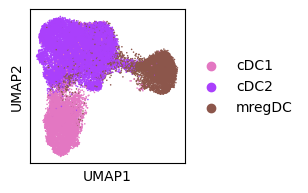

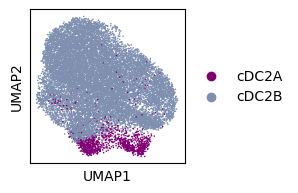

In [5]:
#export high res umap
with plt.rc_context({"figure.figsize": (2, 2)}):
    sc.pl.umap(data, color="MyeloidAPC_Subsets", size=5, title="")
    sc.pl.umap(data_DC, color="NR_annotations_simple", size=5, title="")
    sc.pl.umap(data_DC2, color="cDC2_A-B", size=5, title="")

In [ ]:
#Define sigs
#our in vitro sigs: 
#iv_Uptake_sig = ["CCL22","IL4I1","SIRPA","CCR7","CHST11","GPR157","RGS1","BIRC3","TRAF1","CSF2RA","TBC1D13","LAMP3","MREG","PPP1R14A","SPRED2","CD83","TXN","MOB3A","NFKB1","TBC1D4","CDK2","WFDC21P","ARAP2","ZER1","ACSL1","SPINT2","SQSTM1","TBC1D8","JAG1","AC073508.3","BATF","ETV3","BCL2","KIF2A","FSCN1","TNFAIP3","CCDC28B","NR4A3","CYTIP","PLEK","FOXO1","TOMM34","TRAFD1","PPP1R16B","CXCR4","CD40","ENTPD7","CDKN1A","BID","MARCKS","DUSP5","MAP4K4","BCL2L1","ISG20","RNF145","RNF121","GPR132","RASGEF1B","CYRIA","RAB10","CERS6","IL1R1","STK4","CLEC2D","AL390719.1","ZBTB38","IFNGR2","CD274","SLC41A2","NRP2","ANKRD33B","GPR183","POGLUT1","ADORA2A","JADE3","KHDRBS3","CTNNB1","SLCO5A1","NFKB2","RGS2","SEC61B","ZNRF1","RELB","C12orf45","IRF2","EPOP","MXD1","RAB5B","PADI2","DRAM1","MTMR4","EEF2K","GCNT2","RAPH1","BCL2A1","SEC23B","PIM3","ANTXR2","ABTB2","TMEM200A"] 
#iv_scDC1_sig = ['CPVL','C1orf54','CCND1','CLEC9A','CADM1','PPT1','RGCC','SHTN1','DNASE1L3','CD1A','RAB7B','CPNE3','C15orf48','CD1C','CLEC7A','CAMK2D','BATF3','FGL2','PSMB9','IRF8','EGLN3','HLA-B','WDFY4','BASP1','SPATS2L','ENPP1','S100A10','NDRG2','HLA-C','RNASE6','RGS10','OAT','PTMS','CD74','TAP1','SLAMF8','ASAP1','SNX3','FNBP1','HLA-DOB','CBL','DSE','CHPT1','PLEKHM3','NAAA','AHNAK','SNX22','LMNA','ELOVL5','DIPK2A']  

#Mulder sigs 100 degs: 
# Mulder_CCR7_mDC = ['BIRC3','CCL19','CCR7','CCL22','FSCN1','TXN','MARCKSL1','LAMP3','EBI3','IDO1','MARCKS','TNFAIP2','TMEM176A','NUB1','IL7R','LAD1','RPS27L','RAB9A','RASSF4','MGLL','IL32','DAPP1','DUSP5','ID2','TBC1D4','CRIP1','BTG1','MALAT1','CST7','KIF2A','NRP2','TMEM176B','AOC1','IL4I1','CSF2RA','POGLUT1','NABP1','NCCRP1','CD83','GPR157','ERICH1','GRSF1','GPX4','TUBA1C','CFLAR','CD40','SAMSN1','ANXA6','CDKN1A','RELB','STK4','ISCU','ZFAS1','BASP1','PNRC1','GADD45A','KDM2B','H2AFZ','NMRK1','TRAF1','RP1-28O10.1','RAB8B','PLA2G16','SYNGR2','LY75','CD274','FAM60A','TUBB6','CERS6','GABARAPL2','B2M','ATOX1','LIMCH1','BCL2L14','MAP3K13','PTPN1','CD200','EPSTI1','ARAP2','PPA1','TRAFD1','VOPP1','MYO1G','FNBP1','RFTN1','TRIP10','GPBP1','SIAH2','PTGIR','N4BP2L1','LYST','ARHGAP10','SLCO5A1','SOCS2','HMSD','CYB5A','TVP23A','SEC61B','IL15','CLPTM1']
# Mulder_CD207_DC = ['HLA-DQB2','FCGBP','CD207','CD1A','S100B','TACSTD2','PLEK2','KRT14','HPGDS','HSPA1A','FCER1A','CLDN1','LMNA','LTB','PPM1N','NDRG2','SLC18A2','HLA-DQA2','PKIB','TRPM4','KRT1','C15orf48','CA2','IGLC3','RGS2','GLRX','GNA15','GSN','SERPINF1','PRDX1','IL22RA2','CD59','HSPA6','DSP','DMKN','PTMS','DNAJB1','CSF1R','TUBA1B','KRT10','ALOX5AP','SUCNR1','TMEM14C','NRN1','TBC1D4','S100A4','RGS1','PTGS2','RGS16','JUN','LST1','VASP','HSP90AB1','GTF2IRD1','FILIP1L','CLEC5A','DUSP2','NR4A2','CCND2','QPRT','KRT5','EPCAM','NGFRAP1','CD1E','MSI2','CHAD','FAM46A','IL18','HSP90AA1','DBI','ALOX5','RP11-597D13.8','SLC29A1','TNF','OLFM2','GAS2L3','YWHAH','CKLF','PARM1','HLA-DRB5','MMP9','PERP','RHEB','CTNNBIP1','PPP1R15A','KRTDAP','TSC22D1','CAPG','AKR1A1','CFAP73','ACOT7','RXRA','C6orf48','BAIAP2','RNF5','FFAR4','MT-RNR2','RASGEF1B','CTNND1','SPAG9']
# Mulder_DC1 = ['CLEC9A','C1orf54','SNX3','CPNE3','IRF8','DNASE1L3','CPVL','WDFY4','CADM1','CCND1','RGCC','NAAA','CST3','C1ORF54','XCR1','TACSTD2','MPEG1','PPT1','CLNK','RAB7B','BATF3','LGALS2','ID2','RAB32','TAP1','VMO1','IDO1','RGS10','SHTN1','TMEM14A','FUCA1','SLAMF7','HLA-DOB','S100B','CYB5R3','GYPC','VAC14','MZT2A','KIAA0226L','UCP2','ASB2','HLA-B','ENPP1','NAP1L1','PLCD1','SERPINF2','TMSB4X','LSM6','CAMK2D','ICAM3','FNBP1','HLA-DPB1','KCNK6','C1orf21','HLA-DPA1','PNMA1','PSMB9','PTPRE','FKBP1B','ACTG1','CD74','NET1','ENSA','APOL3','ASAP1','AIM2','LIMD2','EEF1B2','CDK2AP2','SNX22','DBN1','EGLN3','ANPEP','CD59','CCDC126','LSP1','CSRP1','HLA-C','BTLA','FLT3','ACTN1','SLAMF8','TAGLN2','GSTP1','SELPLG','KIF16B','GCSAM','SLC46A3','PPM1J','SLC24A4','TSPAN13','ZNF366','FBXO27','PLPP1','DGAT2','MAP2K6','DPP4','C1orf186','BIK','DYSF'] 
# Mulder_DC2 = ['FCER1A','CD1C','CLEC10A','TXNIP','JAML','FOS','ZFP36L2','RNASE6','CD1D','IFITM2','CASP1','IGSF6','CACNA2D3','FCER1G','LST1','MNDA','CD33','FCGR2B','RNF130','CLEC4A','CFP','CD52','PLD4','CEBPD','IL1R2','S100A4','CD300A','SAMHD1','FXYD5','LRRC25','MEF2C','IFITM3','CD1E','ARHGDIB','CARD16','DOK2','MS4A6A','HLA-DMB','FYB','PHACTR1','GMFG','RGS18','PRAM1','TSC22D3','TNFAIP8L2','POU2F2','CORO1A','LYZ','PTAFR','GAPT','GLIPR1','LIMD2','STK17B','SCIMP','TRAF3IP3','RAC2','ENHO','HLA-DMA','MYO1F','CSF3R','IL18','PLAC8','FAM26F','IFI16','ANXA1','C1ORF162','NCF2','FGR','RGS2','NDRG2','CASP4','AOAH','AP1S2','P2RY13','CD37','KCTD12','HCLS1','CNPY3','CD53','LILRB3','CD302','CPPED1','LY86','ETS2','RACK1','RNASET2','PRELID1','PDK4','C10ORF54','PIP4K2A','DDIT4','SMAP2','RTN1','PTPN6','NCOA4','APEX1','FCGR2A','MARCH1','CAT','MBOAT7'] 
# Mulder_DC3 = ['S100A9','C1QA','C1QB','C1QC','S100A8','CD14','APOE','FCN1','FTL','CTSD','MAFB','VCAN','FCGR3A','CTSB','SERPINA1','CD68','C5AR1','NPC2','CYBB','GLUL','CD163','PSAP','CFD','CEBPB','FCER1G','CTSS','ASAH1','SLC7A7','ITM2B','CSF1R','SLC11A1','FCGR2A','FCGR1A','TMEM176B','ZEB2','TYROBP','C3AR1','S100A4','TSPO','CD63','LAIR1','HCST','AIF1','CSTA','FYB','RNF130','MS4A6A','S100A11','CLEC4E','SLCO2B1','PILRA','GIMAP4','STAB1','CLEC10A','CTSC','VSIG4','MS4A7','IGSF6','OLR1','SOD2','FPR1','TREM2','ACP5','RNASE2','CTSL','S100A12','LYZ','LAPTM5','MS4A4A','F13A1','PLA2G7','TGFBI','GSTO1','FPR3','GPX1','CCL3','LAMP1','CYBA','IER3','LRP1','CTSA','LGALS3','HNMT','KCTD12','LILRB2','PLXDC2','ASGR1','PLIN2','TLR2','TMEM176A','APLP2','IFITM3','TREM1','RNASE1','ATP6V1B2','LILRB4','FN1','AGTRAP','PMP22','MSR1']
# Mulder_Doublets = ['CCL5','IL32','CD3D','TRAC','KLRB1','NKG7','TRBC2','CD7','TRBC1','CD3E','CD2','GZMA','CD69','LCK','CD3G','SPOCK2','RORA','GZMH','ETS1','CD8A','CD27','SYNE2','CD247','ITM2A','LAT','GZMM','SKAP1','BCL11B','CD6','GATA3','CD96','PRF1','ZAP70','SH2D1A','ICOS','IKZF3','RASGRP1','CLEC2D','GNLY','TIGIT','IL2RB','CD8B','SH2D2A','TRAT1','GZMK','PYHIN1','KLRD1','ITK','CCL4','BTG1','IL7R','LBH','PIK3IP1','AC092580.4','SIT1','TC2N','CXCR6','CTSW','ACAP1','GZMB','MIAT','CD40LG','IFNG','OPTN','PRKCH','CD28','TUBA4A','SIRPG','ZFP36L2','RHOH','EVL','46266','XCL2','PBXIP1','ARID5B','BATF','STAT4','RARRES3','TBC1D10C','OCIAD2','CAMK4','THEMIS','FYN','MAF','SCML4','ALOX5AP','SLFN5','ISG20','PPP2R5C','HCST','SLA2','CD5','FAM46C','EML4','FKBP11','HOPX','S100A4','C12orf57','PHLDA1','TNFRSF18']
# Mulder_IL1B_DC = ['G0S2','CXCL8','INSIG1','AREG','IL1B','CREM','PLAUR','IL1R2','TIMP1','REL','NR4A3','GPR183','SRGN','ATP1B3','LMNA','NAMPT','EZR','GPAT3','SLC2A3','FTH1','ZNF331','KDM6B','NFE2L2','VEGFA','SAMSN1','FOSL2','CD1C','PDE4A','FCER1A','CLEC10A','STX11','NLRP3','FCER1G','NINJ1','MXD1','CDKN1A','NR4A2','LITAF','RILPL2','LRRFIP1','ETV3','B3GNT5','NFKB1','SYAP1','DUSP2','EREG','CST7','HBEGF','CXCL16','PIM3','FCGR2B','GK','EMP3','PPIF','AKAP13','RASSF5','PDE4B','GNA13','MAP3K8','FCGR2A','MCL1','MALT1','ARL4C','SELK','VDR','OLR1','C15orf48','LIMS1','AGO2','CD44','GABARAPL1','MAT2A','RALA','ZC3H12A','SERPINB9','CD83','AVPI1','NR4A1','NEAT1','CSRNP1','ETS2','TGIF1','CD55','MS4A7','SLC7A5','SAT1','SIPA1L1','NFKBIA','TNFRSF1B','SATB1','THAP2','IL1R1','FLT1','GLUL','MAFF','ATP13A3','CXCL2','MAP2K3','S100A4','MRC1']
# Mulder_ISG_DC = ['ISG15','IFI6','IFI44L','IFIT3','IFIT1','LY6E','MX1','IFITM3','IFI44','IFIT2','RSAD2','OAS2','CMPK2','XAF1','OAS1','MX2','EIF2AK2','OAS3','IFITM1','IFITM2','EPSTI1','TNFSF10','UBE2L6','STAT1','OASL','IRF7','SAMD9L','HERC5','IFI35','RNF213','SAMD9','USP18','RABGAP1L','BST2','PARP14','TNFSF13B','PARP9','NT5C3A','IFI16','HELZ2','FCER1G','SP110','GBP1','MT2A','LAP3','TYROBP','DDX60','CASP1','IFIH1','ISG20','DDX58','PLSCR1','CXCL10','NMI','SIGLEC1','PLAC8','MNDA','DDX60L','IFI27','TRIM22','IGSF6','C19orf66','ADAR','LGALS9','SERPING1','FCGR2B','CCR1','APOL6','DRAP1','DTX3L','LGALS3BP','SAMHD1','SSB','CARD16','GBP4','CLEC10A','LILRB4','STAT2','FAM26F','SPATS2L','DHX58','FPR3','S100A11','CD1D','APOBEC3A','MS4A6A','PHF11','GRN','TXNIP','NAGK','PML','SP100','HSH2D','TYMP','PNPT1','CHMP5','CD300A','S100A4','CD1C','FCGR2A']
# Mulder_Low_n_feat_DC = ['AIF1','LST1','UQCRB','VAMP8','UQCR10','COMMD6','TOMM7','ATP5J','TMA7','C14orf2','NPC2','ATP5J2','AKR1B1','UQCR11','GLRX','LAMTOR2','NDUFA1','COX7C','CHCHD10','LSM3','C4orf3','SNRPD2','CARD16','NDUFB2','COX6C','NOP10','C19orf53','C6orf48','ATPIF1','EIF3E','PFDN5','MYEOV2','C4orf48','SH3BGRL','COX6B1','UQCRQ','ARPC5','RAC1','PRDX1','PYCARD','ARPC3','RWDD1','USMG5','RPS26','ATP5H','NDUFA12','SKP1','NPM1','C11orf31','ATP6V1F','NDUFA4','NDUFA2','ATP5L','RPL36AL','TCEB2','NDUFB1','DYNLL1','PRDX5','ATP5I','AP2S1','HMGN1','RNF181','WDR83OS','PRELID1','NDUFB3','CLTA','COX7B','C7orf73','DYNLRB1','BRK1','RPA3','POMP','POLR2L','C8orf59','ATOX1','MIF','RBX1','FAM49B','NEDD8','UBL5','C14orf166','GDI2','RANBP1','CCT8','CAPZA2','NDUFB4','SHFM1','POLR2K','SEPW1','EDF1','MNDA','LAMTOR1','GTF2H5','GSN','NDRG2','TUBA1B','S100A11','SERF2','IL18','YBX1']
# Mulder_LTB_DC = ['LTB','IL22RA2','LST1','TNFRSF13C','LINC01531','CEACAM1','ABI3','AAAS','PLAC8','SH3D21','PIK3R6','C1ORF162','FAM110A','CA2','TNNI2','RACK1','SUSD3','ABHD6','ACY3','CLEC4A','HIC1','CD3E','C11ORF31','C12ORF10','RPS3A','FAM107B','RPS4X','PFDN5','C6ORF48','ADA','CDH17','CTD-2006K23.1','C14ORF2','CORO1A','LINC00877','C19ORF43','LYST','PLD4','SMAGP','RPSA','SEPT1','RPS6KA4','C10ORF54','RPS19','C9ORF16','SNAP29','RPL23A','HES4','C14ORF166','EVA1B','DDIT4','FCMR','CDH1','PAK1','C11ORF58','FXYD5','COTL1','MYL12A','PLVAP','C4ORF3','RPL3','JAML','SH3YL1','RPS5','RPL10A','RPL19','CFP','GHRL','C19ORF60','VASP','RPS23','ITGB7','DNAJC4','CHAF1A','C19ORF53','CD52','RPS27A','RPS6','PSTPIP2','RPL15','COMMD6','ENTPD1','KCNMB1','RPS14','RPS3','TSC22D3','FAM26F','CXORF21','RPL13A','RPL13','RPL7A','FAM65B','TLR10','ARHGAP9','GNGT2','UCP2','RPL6','TMEM8B','RPL7','RPS2']
# Mulder_preDC = ['PPP1R14A','LILRA4','ACOT7','C12orf75','CD5','SPIB','PLAC8','TCF4','GZMB','IRF7','LILRB4','IFITM2','SELL','SEPT6','ITM2C','FUZ','CXCR3','SIGLEC6','MYL12A','LGMN','LTB','CYB561A3','SUSD1','PLD4','BCL11A','OPN3','IL3RA','LTK','SOX4','ATF5','CDH1','JCHAIN','AXL','CCND3','ARL4C','ALOX5AP','SCN9A','PTGDS','CD2','HAMP','PLXNA4','GAS6','APP','MAP1A','CLEC4C','RP11-598F7.3','CLIC3','UPK3A','PLP2','ZC3HAV1','CORO1A','SEPT9','TSPAN13','UGCG','LILRA5','SYNGR2','AREG','PTPRS','CSF2RB','LDLRAD4','TSEN54','SLC44A2','CCDC50','LRRFIP1','IGLON5','GPR153','TRIM22','SLC20A1','CD22','SLC15A4','RASGRP2','ALDH2','CXCR4','SEL1L3','CD55','ECE1','CD53','BLNK','THBD','PARK7','UCP2','IRF4','NKG7','DDAH2','BID','INPP4A','AC023590.1','RP4-737E23.2','TRPM4','SLC7A5','TNFRSF21','IFI30','SMPD3','TOB1','YWHAZ','SAMHD1','FAM65B','RASSF5','CYFIP2','CAT']
# Mulder_Prolif_mDC = ['STMN1','HIST1H4C','KIAA0101','HMGB2','UBE2C','TUBB','CKS1B','HMGN2','MKI67','TK1','TUBA1B','TOP2A','TYMS','CENPF','H2AFZ','PCNA','NUSAP1','CDK1','HMGB1','BIRC5','DUT','RRM2','MCM7','CDKN3','CDC20','ZWINT','DTYMK','AURKB','CENPM','PRC1','CCNB2','CLSPN','TPX2','TMEM106C','RAD51AP1','MAD2L1','ASF1B','GGH','ASPM','GINS2','UBE2T','PLK1','HMMR','GTSE1','CDCA3','NUF2','CEP55','CCNA2','SPC25','CDCA5','MYBL2','UHRF1','MND1','CDT1','DLGAP5','HELLS','FEN1','DHFR','CENPN','NCAPH','CENPK','SHCBP1','CENPA','PKMYT1','TROAP','DNAJC9','CDCA8','NCAPG','DEPDC1','TCF19','CENPU','NUCKS1','SMC2','CENPW','FAM111B','KIF2C','TMPO','WDR34','MCM6','CDC45','OIP5','ORC6','RAN','CARHSP1','KIF11','NASP','PTTG1','PRIM1','CCNB1','SNRNP25','CKAP2L','IDH2','CENPE','CCDC34','RNASEH2A','NDC80','RRM1','RANBP1','DTL','CDCA7']

In [32]:
#alternative using only top 10 genes for mulder sigs (IN USE FOR BELOW FIGS)
#our in vitro sigs: 
iv_Uptake_sig = ["CCL22","IL4I1","SIRPA","CCR7","CHST11","GPR157","RGS1","BIRC3","TRAF1","CSF2RA","TBC1D13","LAMP3","MREG","PPP1R14A","SPRED2","CD83","TXN","MOB3A","NFKB1","TBC1D4","CDK2","WFDC21P","ARAP2","ZER1","ACSL1","SPINT2","SQSTM1","TBC1D8","JAG1","AC073508.3","BATF","ETV3","BCL2","KIF2A","FSCN1","TNFAIP3","CCDC28B","NR4A3","CYTIP","PLEK","FOXO1","TOMM34","TRAFD1","PPP1R16B","CXCR4","CD40","ENTPD7","CDKN1A","BID","MARCKS","DUSP5","MAP4K4","BCL2L1","ISG20","RNF145","RNF121","GPR132","RASGEF1B","CYRIA","RAB10","CERS6","IL1R1","STK4","CLEC2D","AL390719.1","ZBTB38","IFNGR2","CD274","SLC41A2","NRP2","ANKRD33B","GPR183","POGLUT1","ADORA2A","JADE3","KHDRBS3","CTNNB1","SLCO5A1","NFKB2","RGS2","SEC61B","ZNRF1","RELB","C12orf45","IRF2","EPOP","MXD1","RAB5B","PADI2","DRAM1","MTMR4","EEF2K","GCNT2","RAPH1","BCL2A1","SEC23B","PIM3","ANTXR2","ABTB2","TMEM200A"] 
iv_scDC1_sig = ['CPVL','C1orf54','CCND1','CLEC9A','CADM1','PPT1','RGCC','SHTN1','DNASE1L3','CD1A','RAB7B','CPNE3','C15orf48','CD1C','CLEC7A','CAMK2D','BATF3','FGL2','PSMB9','IRF8','EGLN3','HLA-B','WDFY4','BASP1','SPATS2L','ENPP1','S100A10','NDRG2','HLA-C','RNASE6','RGS10','OAT','PTMS','CD74','TAP1','SLAMF8','ASAP1','SNX3','FNBP1','HLA-DOB','CBL','DSE','CHPT1','PLEKHM3','NAAA','AHNAK','SNX22','LMNA','ELOVL5','DIPK2A']  

#Mulder sigs 100 degs: 
Mulder_CCR7_mDC = ['BIRC3','CCL19','CCR7','CCL22','FSCN1','TXN','MARCKSL1','LAMP3','EBI3','IDO1']
Mulder_CD207_DC = ['HLA-DQB2','FCGBP','CD207','CD1A','S100B','TACSTD2','PLEK2','KRT14','HPGDS','HSPA1A']
Mulder_DC1 = ['CLEC9A','C1orf54','SNX3','CPNE3','IRF8','DNASE1L3','CPVL','WDFY4','CADM1','CCND1'] 
Mulder_DC2 = ['FCER1A','CD1C','CLEC10A','TXNIP','JAML','FOS','ZFP36L2','RNASE6','CD1D','IFITM2'] 
Mulder_DC3 = ['S100A9','C1QA','C1QB','C1QC','S100A8','CD14','APOE','FCN1','FTL','CTSD']
Mulder_Doublets = ['CCL5','IL32','CD3D','TRAC','KLRB1','NKG7','TRBC2','CD7','TRBC1','CD3E']
Mulder_IL1B_DC = ['G0S2','CXCL8','INSIG1','AREG','IL1B','CREM','PLAUR','IL1R2','TIMP1','REL']
Mulder_ISG_DC = ['ISG15','IFI6','IFI44L','IFIT3','IFIT1','LY6E','MX1','IFITM3','IFI44','IFIT2']
Mulder_Low_n_feat_DC = ['AIF1','LST1','UQCRB','VAMP8','UQCR10','COMMD6','TOMM7','ATP5J','TMA7','C14orf2']
Mulder_LTB_DC = ['LTB','IL22RA2','LST1','TNFRSF13C','LINC01531','CEACAM1','ABI3','AAAS','PLAC8','SH3D21']
Mulder_preDC = ['PPP1R14A','LILRA4','ACOT7','C12orf75','CD5','SPIB','PLAC8','TCF4','GZMB','IRF7']
Mulder_Prolif_mDC = ['STMN1','HIST1H4C','KIAA0101','HMGB2','UBE2C','TUBB','CKS1B','HMGN2','MKI67','TK1']

In [33]:
# Define dictionary of gene sets
gene_sets = {
    "iv_Uptake_sig": iv_Uptake_sig,
    "iv_scDC1_sig": iv_scDC1_sig,
    "Mulder_CCR7_mDC": Mulder_CCR7_mDC,
    "Mulder_CD207_DC": Mulder_CD207_DC,
    "Mulder_DC1": Mulder_DC1,
    "Mulder_DC2": Mulder_DC2,
    "Mulder_DC3": Mulder_DC3,
    "Mulder_Doublets": Mulder_Doublets,
    "Mulder_IL1B_DC": Mulder_IL1B_DC,
    "Mulder_ISG_DC": Mulder_ISG_DC,
    "Mulder_Low_n_feat_DC": Mulder_Low_n_feat_DC,
    "Mulder_LTB_DC": Mulder_LTB_DC,
    "Mulder_preDC": Mulder_preDC,
    "Mulder_Prolif_mDC": Mulder_Prolif_mDC
}

In [34]:
# Loop through each gene set and calculate the scores
for name, genes in gene_sets.items():
    sc.tl.score_genes(data, genes, score_name=name)

for name, genes in gene_sets.items():
    sc.tl.score_genes(data_DC, genes, score_name=name)

for name, genes in gene_sets.items():
    sc.tl.score_genes(data_DC2, genes, score_name=name)

In [35]:
colour_vars_1 = ["iv_Uptake_sig","iv_scDC1_sig","Mulder_CCR7_mDC","Mulder_CD207_DC","Mulder_DC1","Mulder_DC2","Mulder_DC3","Mulder_Doublets","Mulder_IL1B_DC",
    "Mulder_ISG_DC","Mulder_Low_n_feat_DC","Mulder_LTB_DC","Mulder_preDC","Mulder_Prolif_mDC","MyeloidAPC_Subsets"]

colour_vars_2 = ["iv_Uptake_sig","iv_scDC1_sig","Mulder_CCR7_mDC","Mulder_CD207_DC","Mulder_DC1","Mulder_DC2","Mulder_DC3","Mulder_Doublets","Mulder_IL1B_DC",
    "Mulder_ISG_DC","Mulder_Low_n_feat_DC","Mulder_LTB_DC","Mulder_preDC","Mulder_Prolif_mDC","NR_annotations_simple"]

colour_vars_3 = ["iv_Uptake_sig","iv_scDC1_sig","Mulder_CCR7_mDC","Mulder_CD207_DC","Mulder_DC1","Mulder_DC2","Mulder_DC3","Mulder_Doublets","Mulder_IL1B_DC",
    "Mulder_ISG_DC","Mulder_Low_n_feat_DC","Mulder_LTB_DC","Mulder_preDC","Mulder_Prolif_mDC","cDC2_A-B"]

In [ ]:
colour_vars_iv = ["iv_Uptake_sig","iv_scDC1_sig"]

In [6]:
sc.set_figure_params(dpi=100, dpi_save=700, vector_friendly=True, format='svg') #only run when exporting umaps

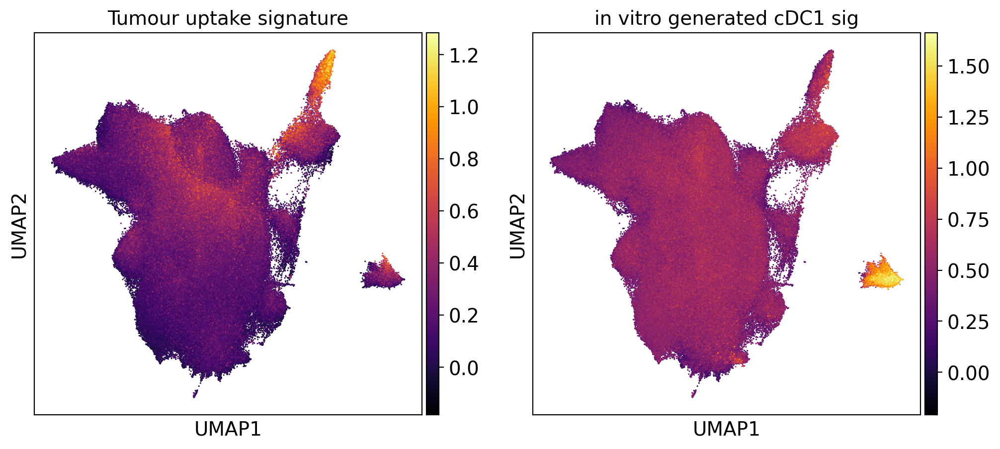

In [18]:
#plotting in vitro sigs overlay
with plt.rc_context({"figure.figsize": (5, 5)}):
    sc.pl.umap(data, color=colour_vars_iv, ncols=2, size=5, cmap="inferno", title=["Tumour uptake signature","in vitro generated cDC1 sig"], save="_NR_Atlas_Invitro_overlay.pdf") 

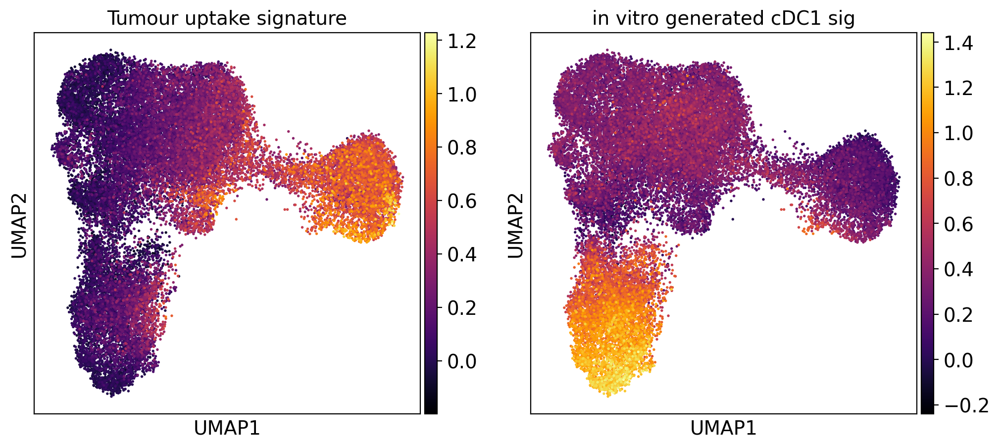

In [21]:
#plotting in vitro sigs overlay
with plt.rc_context({"figure.figsize": (5, 5)}):
    sc.pl.umap(data_DC, color=colour_vars_iv, ncols=2, size=15, cmap="inferno", title=["Tumour uptake signature","in vitro generated cDC1 sig"], save="_NR_Atlas_Invitro_overlay_DC.pdf")

In [7]:
colour_vars_All = ["Mulder_CCR7_mDC","Mulder_CD207_DC","Mulder_DC1","Mulder_DC2","Mulder_DC3","Mulder_IL1B_DC",
    "Mulder_ISG_DC","Mulder_LTB_DC","MyeloidAPC_Subsets"]

colour_vars_DC = ["Mulder_CCR7_mDC","Mulder_CD207_DC","Mulder_DC1","Mulder_DC2","Mulder_DC3","Mulder_IL1B_DC",
    "Mulder_ISG_DC","Mulder_LTB_DC","NR_annotations_simple"]

colour_vars_DC2 = ["Mulder_CD207_DC","Mulder_DC2","Mulder_DC3","Mulder_IL1B_DC",
    "Mulder_ISG_DC","Mulder_LTB_DC","cDC2_A-B"]

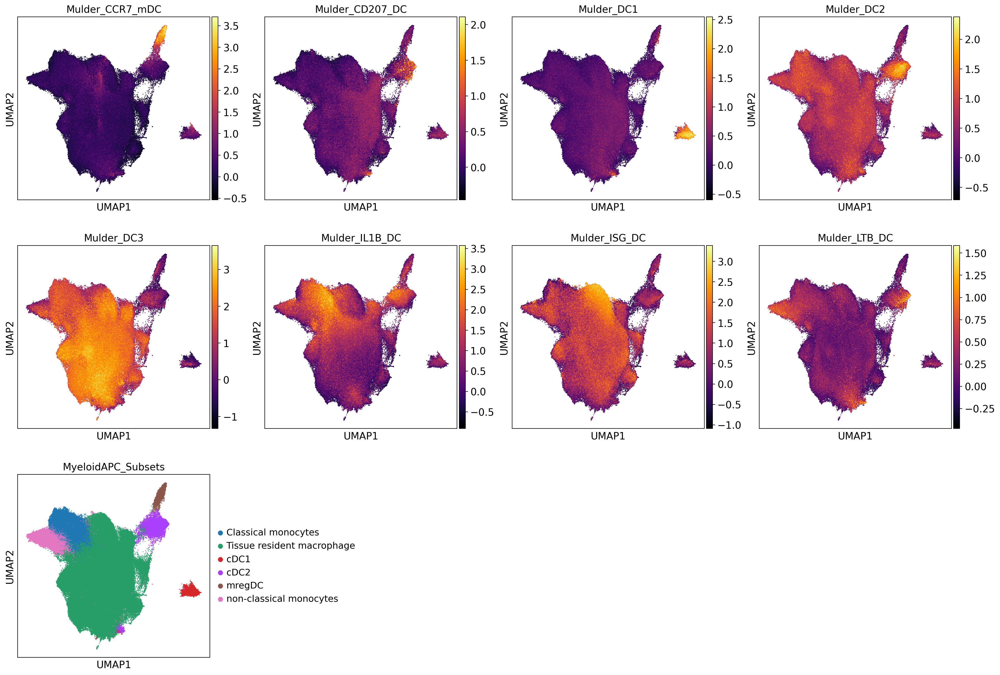

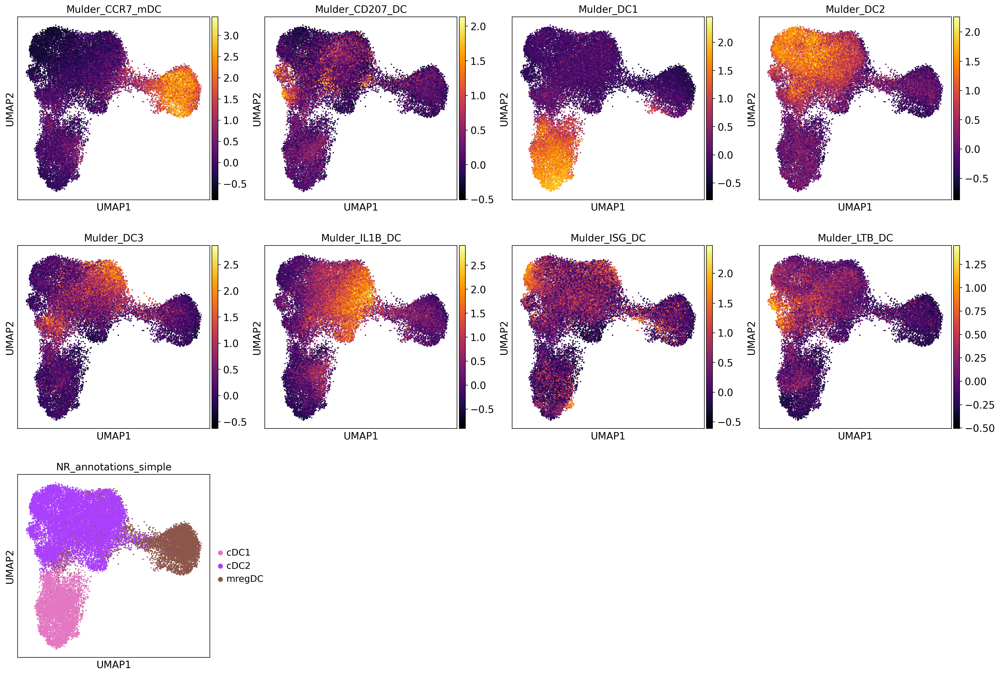

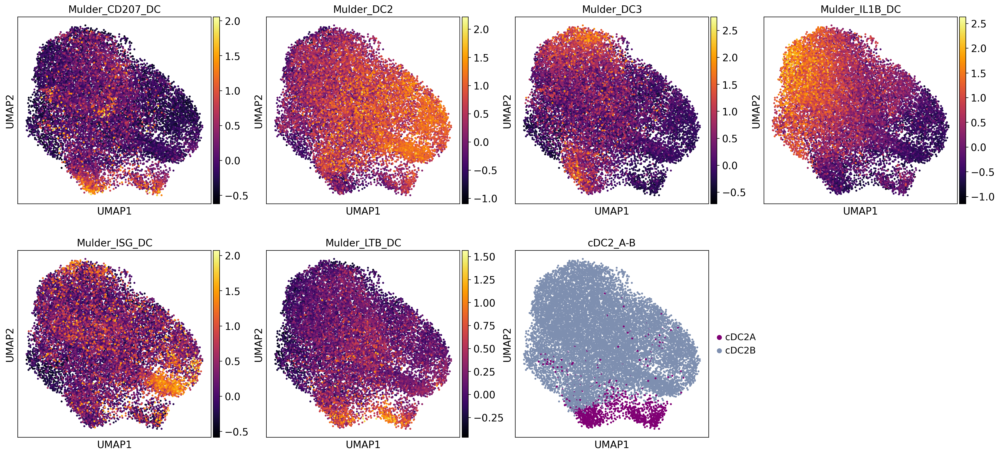

In [39]:
#plotting 
with plt.rc_context({"figure.figsize": (5, 5)}): 
    sc.pl.umap(data, color=colour_vars_All, ncols=4, size=5, cmap="inferno", save="_NR_Atlas_Mulder_overlay_AllAtlas.pdf")
    sc.pl.umap(data_DC, color=colour_vars_DC, ncols=4, size=15, cmap="inferno", save="_NR_Atlas_Mulder_overlay_AllDC.pdf")
    sc.pl.umap(data_DC2, color=colour_vars_DC2, ncols=4, size=30, cmap="inferno", save="_NR_Atlas_Mulder_overlay_DC2.pdf")

In [8]:
# repeat with top 50 degs

#Mulder sigs 50 degs: 
Mulder_CCR7_mDC = ['BIRC3','CCL19','CCR7','CCL22','FSCN1','TXN','MARCKSL1','LAMP3','EBI3','IDO1','MARCKS','TNFAIP2','TMEM176A','NUB1','IL7R','LAD1','RPS27L','RAB9A','RASSF4','MGLL','IL32','DAPP1','DUSP5','ID2','TBC1D4','CRIP1','BTG1','MALAT1','CST7','KIF2A','NRP2','TMEM176B','AOC1','IL4I1','CSF2RA','POGLUT1','NABP1','NCCRP1','CD83','GPR157','ERICH1','GRSF1','GPX4','TUBA1C','CFLAR','CD40','SAMSN1','ANXA6','CDKN1A','RELB']
Mulder_CD207_DC = ['HLA-DQB2','FCGBP','CD207','CD1A','S100B','TACSTD2','PLEK2','KRT14','HPGDS','HSPA1A','FCER1A','CLDN1','LMNA','LTB','PPM1N','NDRG2','SLC18A2','HLA-DQA2','PKIB','TRPM4','KRT1','C15orf48','CA2','IGLC3','RGS2','GLRX','GNA15','GSN','SERPINF1','PRDX1','IL22RA2','CD59','HSPA6','DSP','DMKN','PTMS','DNAJB1','CSF1R','TUBA1B','KRT10','ALOX5AP','SUCNR1','TMEM14C','NRN1','TBC1D4','S100A4','RGS1','PTGS2','RGS16','JUN']
Mulder_DC1 = ['CLEC9A','C1orf54','SNX3','CPNE3','IRF8','DNASE1L3','CPVL','WDFY4','CADM1','CCND1','RGCC','NAAA','CST3','C1ORF54','XCR1','TACSTD2','MPEG1','PPT1','CLNK','RAB7B','BATF3','LGALS2','ID2','RAB32','TAP1','VMO1','IDO1','RGS10','SHTN1','TMEM14A','FUCA1','SLAMF7','HLA-DOB','S100B','CYB5R3','GYPC','VAC14','MZT2A','KIAA0226L','UCP2','ASB2','HLA-B','ENPP1','NAP1L1','PLCD1','SERPINF2','TMSB4X','LSM6','CAMK2D','ICAM3'] 
Mulder_DC2 = ['FCER1A','CD1C','CLEC10A','TXNIP','JAML','FOS','ZFP36L2','RNASE6','CD1D','IFITM2','CASP1','IGSF6','CACNA2D3','FCER1G','LST1','MNDA','CD33','FCGR2B','RNF130','CLEC4A','CFP','CD52','PLD4','CEBPD','IL1R2','S100A4','CD300A','SAMHD1','FXYD5','LRRC25','MEF2C','IFITM3','CD1E','ARHGDIB','CARD16','DOK2','MS4A6A','HLA-DMB','FYB','PHACTR1','GMFG','RGS18','PRAM1','TSC22D3','TNFAIP8L2','POU2F2','CORO1A','LYZ','PTAFR','GAPT'] 
Mulder_DC3 = ['S100A9','C1QA','C1QB','C1QC','S100A8','CD14','APOE','FCN1','FTL','CTSD','MAFB','VCAN','FCGR3A','CTSB','SERPINA1','CD68','C5AR1','NPC2','CYBB','GLUL','CD163','PSAP','CFD','CEBPB','FCER1G','CTSS','ASAH1','SLC7A7','ITM2B','CSF1R','SLC11A1','FCGR2A','FCGR1A','TMEM176B','ZEB2','TYROBP','C3AR1','S100A4','TSPO','CD63','LAIR1','HCST','AIF1','CSTA','FYB','RNF130','MS4A6A','S100A11','CLEC4E','SLCO2B1']
Mulder_Doublets = ['CCL5','IL32','CD3D','TRAC','KLRB1','NKG7','TRBC2','CD7','TRBC1','CD3E','CD2','GZMA','CD69','LCK','CD3G','SPOCK2','RORA','GZMH','ETS1','CD8A','CD27','SYNE2','CD247','ITM2A','LAT','GZMM','SKAP1','BCL11B','CD6','GATA3','CD96','PRF1','ZAP70','SH2D1A','ICOS','IKZF3','RASGRP1','CLEC2D','GNLY','TIGIT','IL2RB','CD8B','SH2D2A','TRAT1','GZMK','PYHIN1','KLRD1','ITK','CCL4','BTG1']
Mulder_IL1B_DC = ['G0S2','CXCL8','INSIG1','AREG','IL1B','CREM','PLAUR','IL1R2','TIMP1','REL','NR4A3','GPR183','SRGN','ATP1B3','LMNA','NAMPT','EZR','GPAT3','SLC2A3','FTH1','ZNF331','KDM6B','NFE2L2','VEGFA','SAMSN1','FOSL2','CD1C','PDE4A','FCER1A','CLEC10A','STX11','NLRP3','FCER1G','NINJ1','MXD1','CDKN1A','NR4A2','LITAF','RILPL2','LRRFIP1','ETV3','B3GNT5','NFKB1','SYAP1','DUSP2','EREG','CST7','HBEGF','CXCL16','PIM3']
Mulder_ISG_DC = ['ISG15','IFI6','IFI44L','IFIT3','IFIT1','LY6E','MX1','IFITM3','IFI44','IFIT2','RSAD2','OAS2','CMPK2','XAF1','OAS1','MX2','EIF2AK2','OAS3','IFITM1','IFITM2','EPSTI1','TNFSF10','UBE2L6','STAT1','OASL','IRF7','SAMD9L','HERC5','IFI35','RNF213','SAMD9','USP18','RABGAP1L','BST2','PARP14','TNFSF13B','PARP9','NT5C3A','IFI16','HELZ2','FCER1G','SP110','GBP1','MT2A','LAP3','TYROBP','DDX60','CASP1','IFIH1','ISG20']
Mulder_Low_n_feat_DC = ['AIF1','LST1','UQCRB','VAMP8','UQCR10','COMMD6','TOMM7','ATP5J','TMA7','C14orf2','NPC2','ATP5J2','AKR1B1','UQCR11','GLRX','LAMTOR2','NDUFA1','COX7C','CHCHD10','LSM3','C4orf3','SNRPD2','CARD16','NDUFB2','COX6C','NOP10','C19orf53','C6orf48','ATPIF1','EIF3E','PFDN5','MYEOV2','C4orf48','SH3BGRL','COX6B1','UQCRQ','ARPC5','RAC1','PRDX1','PYCARD','ARPC3','RWDD1','USMG5','RPS26','ATP5H','NDUFA12','SKP1','NPM1','C11orf31','ATP6V1F']
Mulder_LTB_DC = ['LTB','IL22RA2','LST1','TNFRSF13C','LINC01531','CEACAM1','ABI3','AAAS','PLAC8','SH3D21','PIK3R6','C1ORF162','FAM110A','CA2','TNNI2','RACK1','SUSD3','ABHD6','ACY3','CLEC4A','HIC1','CD3E','C11ORF31','C12ORF10','RPS3A','FAM107B','RPS4X','PFDN5','C6ORF48','ADA','CDH17','CTD-2006K23.1','C14ORF2','CORO1A','LINC00877','C19ORF43','LYST','PLD4','SMAGP','RPSA','SEPT1','RPS6KA4','C10ORF54','RPS19','C9ORF16','SNAP29','RPL23A','HES4','C14ORF166','EVA1B']
Mulder_preDC = ['PPP1R14A','LILRA4','ACOT7','C12orf75','CD5','SPIB','PLAC8','TCF4','GZMB','IRF7','LILRB4','IFITM2','SELL','SEPT6','ITM2C','FUZ','CXCR3','SIGLEC6','MYL12A','LGMN','LTB','CYB561A3','SUSD1','PLD4','BCL11A','OPN3','IL3RA','LTK','SOX4','ATF5','CDH1','JCHAIN','AXL','CCND3','ARL4C','ALOX5AP','SCN9A','PTGDS','CD2','HAMP','PLXNA4','GAS6','APP','MAP1A','CLEC4C','RP11-598F7.3','CLIC3','UPK3A','PLP2','ZC3HAV1']
Mulder_Prolif_mDC = ['STMN1','HIST1H4C','KIAA0101','HMGB2','UBE2C','TUBB','CKS1B','HMGN2','MKI67','TK1','TUBA1B','TOP2A','TYMS','CENPF','H2AFZ','PCNA','NUSAP1','CDK1','HMGB1','BIRC5','DUT','RRM2','MCM7','CDKN3','CDC20','ZWINT','DTYMK','AURKB','CENPM','PRC1','CCNB2','CLSPN','TPX2','TMEM106C','RAD51AP1','MAD2L1','ASF1B','GGH','ASPM','GINS2','UBE2T','PLK1','HMMR','GTSE1','CDCA3','NUF2','CEP55','CCNA2','SPC25','CDCA5']

In [9]:
# Define dictionary of gene sets
gene_sets = {
    "Mulder_CCR7_mDC": Mulder_CCR7_mDC,
    "Mulder_CD207_DC": Mulder_CD207_DC,
    "Mulder_DC1": Mulder_DC1,
    "Mulder_DC2": Mulder_DC2,
    "Mulder_DC3": Mulder_DC3,
    "Mulder_Doublets": Mulder_Doublets,
    "Mulder_IL1B_DC": Mulder_IL1B_DC,
    "Mulder_ISG_DC": Mulder_ISG_DC,
    "Mulder_Low_n_feat_DC": Mulder_Low_n_feat_DC,
    "Mulder_LTB_DC": Mulder_LTB_DC,
    "Mulder_preDC": Mulder_preDC,
    "Mulder_Prolif_mDC": Mulder_Prolif_mDC
}

In [10]:
# Loop through each gene set and calculate the scores
for name, genes in gene_sets.items():
    sc.tl.score_genes(data, genes, score_name=name)

for name, genes in gene_sets.items():
    sc.tl.score_genes(data_DC, genes, score_name=name)

for name, genes in gene_sets.items():
    sc.tl.score_genes(data_DC2, genes, score_name=name)

       'ATP5H', 'C11orf31'],
      dtype='object')
       'CTD-2006K23.1', 'C14ORF2', 'C19ORF43', 'SEPT1', 'C10ORF54', 'C9ORF16',
       'C14ORF166'],
      dtype='object')
       'ATP5H', 'C11orf31'],
      dtype='object')
       'CTD-2006K23.1', 'C14ORF2', 'C19ORF43', 'SEPT1', 'C10ORF54', 'C9ORF16',
       'C14ORF166'],
      dtype='object')
       'ATP5H', 'C11orf31'],
      dtype='object')
       'CTD-2006K23.1', 'C14ORF2', 'C19ORF43', 'SEPT1', 'C10ORF54', 'C9ORF16',
       'C14ORF166'],
      dtype='object')


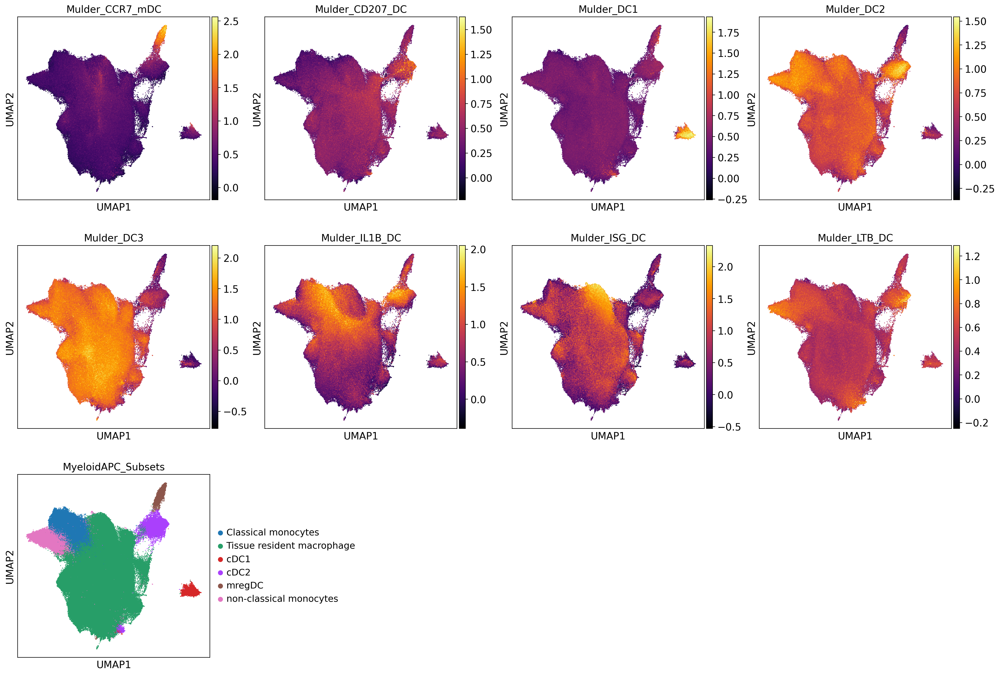

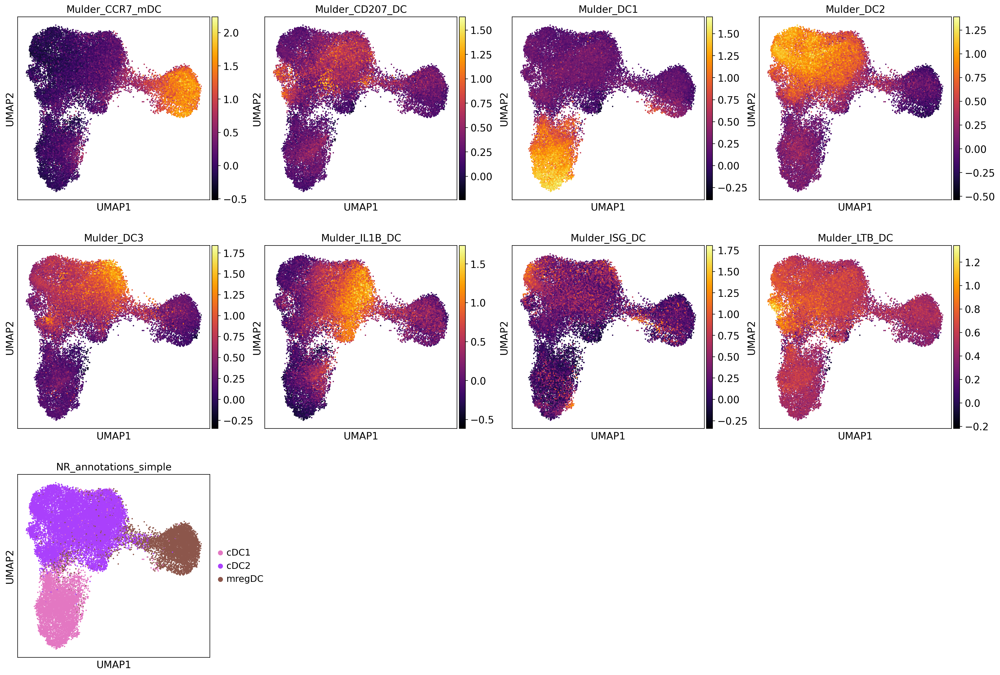

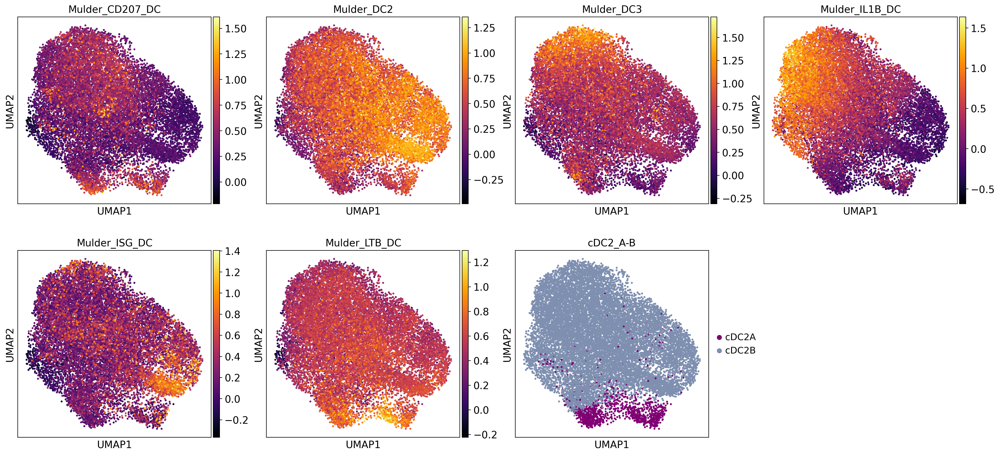

In [11]:
#plotting 
with plt.rc_context({"figure.figsize": (5, 5)}): 
    sc.pl.umap(data, color=colour_vars_All, ncols=4, size=5, cmap="inferno", save="_NR_Atlas_Mulder_overlay_AllAtlas_50.pdf")
    sc.pl.umap(data_DC, color=colour_vars_DC, ncols=4, size=15, cmap="inferno", save="_NR_Atlas_Mulder_overlay_AllDC_50.pdf")
    sc.pl.umap(data_DC2, color=colour_vars_DC2, ncols=4, size=30, cmap="inferno", save="_NR_Atlas_Mulder_overlay_DC2_50.pdf")